# Initial Processing of the GEX Data 
With the GEX, we had a _slight_ wetting failure. Because of this wetting failure on well 5, the ranked UMI plot doesn't look as nice as it should. For that reason, in the beginning of the notebook, I use the mouse transcripts that were mixed with our sample (because we ran with Matt Schmitz' cells) in order to reliably call human cells. After this, I do regular processing and discover that the well that had the wetting failure seems to mostly produce cells that cluster with the normal populations, but there is one relatively large population that seems to be coming from well 5. I then ran this notebook multiple times, trying to eliminate that population through regression of ribosomal genes or running combat, but they are to no avail. I would like to separate out those attempts in a separate notebook, but for now, I'm just planning on subclustering and removing the clusters that seem to be dominated by only one batch. I'm pretty sure a doublet finder algorithm would be able to remove them, and I should also experiment with running that later as well.

In [42]:
import scanpy as sc
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import warnings
import itertools as it
import json
import requests
import seaborn as sns
import pickle as pkl

In [2]:
sc.settings.verbosity = 4
sc.settings.set_figure_params(dpi=80)
print(sc.__version__)
sc.settings.n_jobs=16

1.4.5.post1


In [3]:
prefix = '/data/codec/pilot.amo.oct19/mrna/'

## Load in the Data

In [4]:
wells = dict()
for well in range(1,6):
    wells[well] = dict()
    wells[well]['adata_h'] = sc.read_10x_h5(prefix + "well%s/outs/raw_feature_bc_matrix.h5" % well, genome='hg38')
    wells[well]['adata_h'].var_names_make_unique()
    wells[well]['adata_m'] = sc.read_10x_h5(prefix + "well%s/outs/raw_feature_bc_matrix.h5" % well, genome='mm10')
    wells[well]['adata_m'].var_names_make_unique()
    print(wells[well]['adata_h'].obs_vector('hg38_______ACE2').sum())

reading /data/codec/pilot.amo.oct19/mrna/well1/outs/raw_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:09)
reading /data/codec/pilot.amo.oct19/mrna/well1/outs/raw_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:08)
2.0
reading /data/codec/pilot.amo.oct19/mrna/well2/outs/raw_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:09)
reading /data/codec/pilot.amo.oct19/mrna/well2/outs/raw_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:08)
1.0
reading /data/codec/pilot.amo.oct19/mrna/well3/outs/raw_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:08)
reading /data/codec/pilot.amo.oct19/mrna/well3/outs/raw_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:08)
0.0
reading /data/codec/pilot.amo.oct19/mrna/well4/outs/raw_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:09)
reading /data/codec/pilot.amo.oct19/mrna/well4/outs/raw_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:08)
0.0
reading /data/codec/pilot.amo.oct19/mrna/well5/outs/raw_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:10)
reading /data/codec/pilot.amo.oct19/mrna/well5/outs/raw_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:10)
0.0


## Processing

Remove cells and genes that contain 0 counts.

In [5]:
for well in wells:
    for adata in ['adata_h', 'adata_m']:
        sc.pp.filter_cells(wells[well][adata], min_counts=1)
        sc.pp.filter_genes(wells[well][adata], min_counts=1)
        wells[well][adata + '-filter_cells_n_counts'] = wells[well][adata].obs['n_counts'].sort_values(ascending=False)

filtered out 6020220 cells that have less than 1 counts


Trying to set attribute `.obs` of view, copying.


filtered out 12746 genes that are detected in less than 1 counts
filtered out 5347333 cells that have less than 1 counts


Trying to set attribute `.obs` of view, copying.


filtered out 12604 genes that are detected in less than 1 counts
filtered out 6184059 cells that have less than 1 counts


Trying to set attribute `.obs` of view, copying.


filtered out 13427 genes that are detected in less than 1 counts
filtered out 5376313 cells that have less than 1 counts


Trying to set attribute `.obs` of view, copying.


filtered out 12626 genes that are detected in less than 1 counts
filtered out 6141518 cells that have less than 1 counts


Trying to set attribute `.obs` of view, copying.


filtered out 13453 genes that are detected in less than 1 counts
filtered out 5280341 cells that have less than 1 counts


Trying to set attribute `.obs` of view, copying.


filtered out 12695 genes that are detected in less than 1 counts
filtered out 5924908 cells that have less than 1 counts


Trying to set attribute `.obs` of view, copying.


filtered out 12397 genes that are detected in less than 1 counts
filtered out 5514936 cells that have less than 1 counts


Trying to set attribute `.obs` of view, copying.


filtered out 12720 genes that are detected in less than 1 counts
filtered out 6000629 cells that have less than 1 counts


Trying to set attribute `.obs` of view, copying.


filtered out 11329 genes that are detected in less than 1 counts
filtered out 5893391 cells that have less than 1 counts


Trying to set attribute `.obs` of view, copying.


filtered out 12857 genes that are detected in less than 1 counts


#### Knee plots.
I've decided to take a different approach in light of my recent analysis of the spatial project. Here I'm line-plotting the ranked genes by each genome, but then scatter-plotting the equivalent UMIs of the opposite genome. This shows a really nice distinction between mouse and human cells, and mouse and human background transcripts.

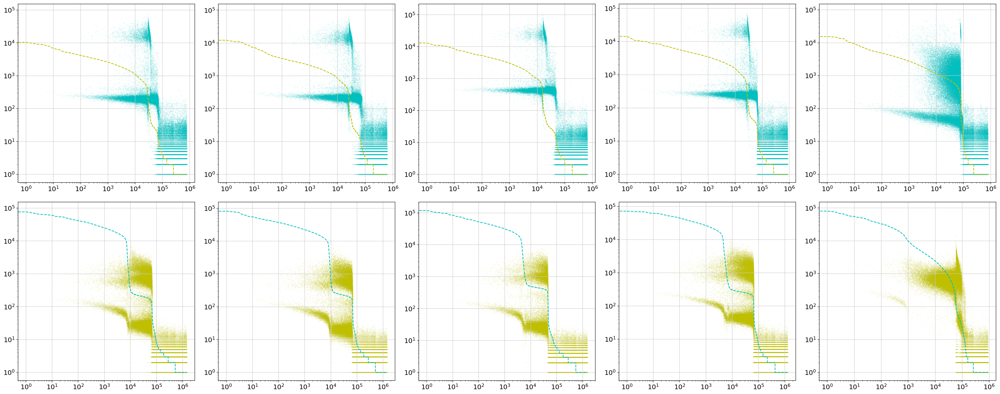

In [6]:
fig, ax = plt.subplots(2, 5, figsize=(30,12))
for prod, ax in tqdm(list(zip(it.product(range(1,6), ['adata_h', 'adata_m']), np.ravel(ax.T))), total=10):
    series = wells[prod[0]][prod[1] + '-filter_cells_n_counts']
    if prod[1] == 'adata_h':
        ax.scatter(range(len(series)), wells[prod[0]]['adata_m'].obs['n_counts'][series.index.values].values, color='c', alpha=0.1, s=3, linewidth='0')
        ax.plot(series.values, color='y', linestyle='--')
    else:
        ax.scatter(range(len(series)), wells[prod[0]]['adata_h'].obs['n_counts'][series.index.values].values, color='y', alpha=0.1, s=3, linewidth='0')
        ax.plot(series.values, color='c', linestyle='--')
    ax.set_xscale('log')
    ax.set_yscale('log')
plt.tight_layout()

It is now so clear to me. Maybe we should start putting EERC spike-in into the runs. It will help with ambient RNA, and probably with demuxlet too, and I _don't_ think you need a deep generative model to figure out what each population is. 

As can be seen, the well with the wetting failure (Well 5) looks really messed up, but I think with this visualization it still might be possible to recover good data!

#### Lower Gate
Let's take a closer look at the areas of interest:

In [7]:
lower_ranges = [(5e3, 4e4), (5e3, 4e4), (3e3, 3e4), (2e3, 3e4), (5.5e4, 1e5)]

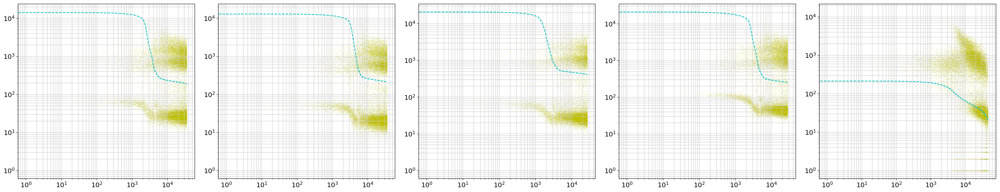

In [8]:
fig, ax = plt.subplots(1, 5, figsize=(30,6))
for prod, ax, xlim in tqdm(list(zip(it.product(range(1,6), ['adata_m']), np.ravel(ax.T), lower_ranges)), total=5):
    series = wells[prod[0]][prod[1] + '-filter_cells_n_counts'][int(xlim[0]):int(xlim[1])]
    ax.scatter(range(len(series)), wells[prod[0]]['adata_h'].obs['n_counts'][series.index.values].values, color='y', alpha=0.1, s=3, linewidth='0')
    ax.plot(series.values, color='c', linestyle='--')
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.grid(False) # turn off major, or else major will turn off while minor turns on
    ax.grid(which='both',axis='both')
plt.tight_layout()

In [9]:
lower_vlines = [4e3, 6e3, 3.5e3, 5e3, 6e3]

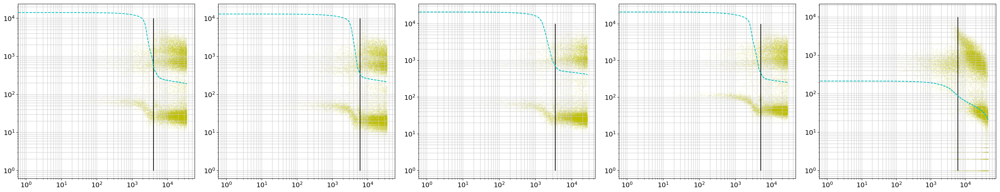

In [10]:
fig, ax = plt.subplots(1, 5, figsize=(30,6))
for prod, ax, xlim, vline in tqdm(list(zip(it.product(range(1,6), ['adata_m']), np.ravel(ax.T), lower_ranges, lower_vlines)), total=5):
    series = wells[prod[0]][prod[1] + '-filter_cells_n_counts'][int(xlim[0]):int(xlim[1])]
    ax.scatter(range(len(series)), wells[prod[0]]['adata_h'].obs['n_counts'][series.index.values].values, color='y', alpha=0.1, s=3, linewidth='0')
    ax.plot(series.values, color='c', linestyle='--')
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.grid(False) # turn off major, or else major will turn off while minor turns on
    ax.grid(which='both',axis='both')
    ax.vlines(vline, 1, 1e4)
plt.tight_layout()

#### Upper Gate

In [11]:
upper_ranges = [(5e4, 9e4), (5e4, 9e4), (3e4, 6e4), (4e4, 8e4), (8e4, 2e5)]

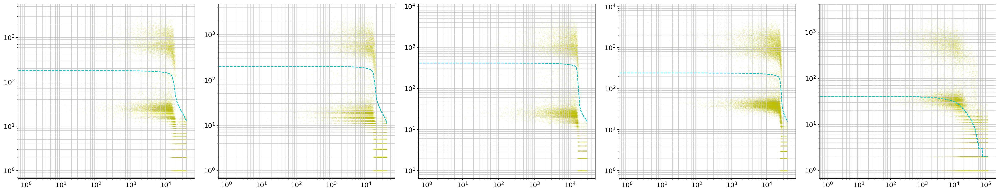

In [12]:
fig, ax = plt.subplots(1, 5, figsize=(30,6))
for prod, ax, xlim in tqdm(list(zip(it.product(range(1,6), ['adata_m']), np.ravel(ax.T), upper_ranges)), total=5):
    series = wells[prod[0]][prod[1] + '-filter_cells_n_counts'][int(xlim[0]):int(xlim[1])]
    ax.scatter(range(len(series)), wells[prod[0]]['adata_h'].obs['n_counts'][series.index.values].values, color='y', alpha=0.1, s=3, linewidth='0')
    ax.plot(series.values, color='c', linestyle='--')
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.grid(False) # turn off major, or else major will turn off while minor turns on
    ax.grid(which='both',axis='both')
plt.tight_layout()

In [13]:
upper_vlines = [1.5e4, 1.5e4, 1.4e4, 2.1e4, 2e4]

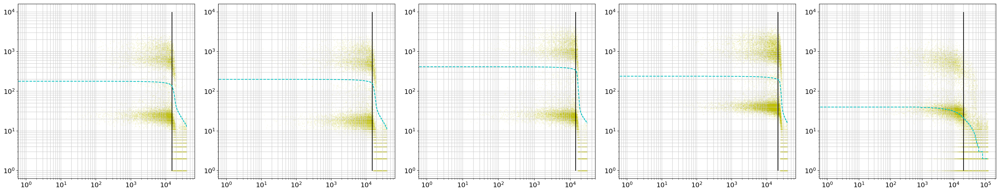

In [14]:
fig, ax = plt.subplots(1, 5, figsize=(30,6))
for prod, ax, xlim, vline in tqdm(list(zip(it.product(range(1,6), ['adata_m']), np.ravel(ax.T), upper_ranges, upper_vlines)), total=5):
    series = wells[prod[0]][prod[1] + '-filter_cells_n_counts'][int(xlim[0]):int(xlim[1])]
    ax.scatter(range(len(series)), wells[prod[0]]['adata_h'].obs['n_counts'][series.index.values].values, color='y', alpha=0.1, s=3, linewidth='0')
    ax.plot(series.values, color='c', linestyle='--')
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.grid(False) # turn off major, or else major will turn off while minor turns on
    ax.grid(which='both',axis='both')
    ax.vlines(vline, 1, 1e4)
plt.tight_layout()

In [15]:
ranges = list()
for l_r, l_v, u_r, u_v in zip(lower_ranges, 
                              lower_vlines, 
                              upper_ranges, 
                              upper_vlines):
    ranges.append((l_r[0] + l_v, u_r[0] + u_v))

In [16]:
umi_cutoffs = [250, 250, 400, 400, 250]

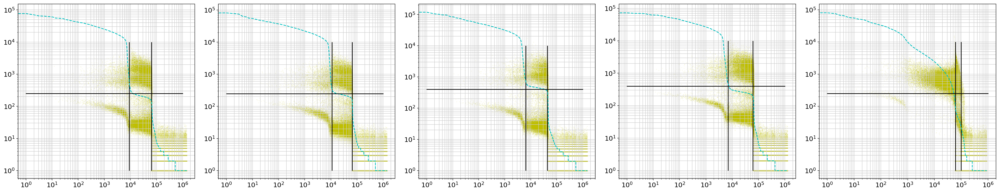

In [17]:
fig, ax = plt.subplots(1, 5, figsize=(30,6))
for prod, ax, xlim, umi_c in tqdm(list(zip(it.product(range(1,6), ['adata_m']), np.ravel(ax.T), ranges, umi_cutoffs)), total=5):
    series = wells[prod[0]][prod[1] + '-filter_cells_n_counts']
    ax.scatter(range(len(series)), wells[prod[0]]['adata_h'].obs['n_counts'][series.index.values].values, color='y', alpha=0.1, s=3, linewidth='0')
    ax.plot(series.values, color='c', linestyle='--')
    ax.plot([1, 1e6], [umi_c, umi_c], color='k')
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.grid(False) # turn off major, or else major will turn off while minor turns on
    ax.grid(which='both',axis='both')
    ax.vlines(xlim[0], 1, 1e4)
    ax.vlines(xlim[1], 1, 1e4)    
plt.tight_layout()

If you try to visualize mentally, the knee plot for the opposite genome is just a projection onto the Y axis of each plot. For the first 4 wells, this would actually capture most of the cells I'm capturing with the above visualization method. However, for well 5, that would grab a TON of what I think is background human RNA. We can salvage the data from that last well using this method because we're excluding that background.

#### Remove Background

I would like to subset the drops and separate the drops into those with cells and those with background. Because there's so few in background as compare to droplets, for now I'm not going to correct for them but maybe later I will.

In [18]:
for prod, xlim, umi_c in tqdm(list(zip(it.product(range(1,6), ['adata_m']), ranges, umi_cutoffs)), total=5):
    series = wells[prod[0]][prod[1] + '-filter_cells_n_counts'][int(xlim[0]):int(xlim[1])]
    
    # need to take overlap because there will be a few bad apples (min_count=0) that were removed from adata_h 
    overlap = np.intersect1d(series.index.values, wells[prod[0]]['adata_h'].obs_names, assume_unique=True)
    
    wells[prod[0]]['adata_h'] = wells[prod[0]]['adata_h'][overlap].copy()
    
    # make a new covariate in the obs
    background_list = list()
    for count in wells[prod[0]]['adata_h'].obs['n_counts']:
        if count < umi_c:
            background_list.append('True')
        else:
            background_list.append('False')
    wells[prod[0]]['adata_h'].obs['background'] = background_list

In [19]:
for well in wells:
    print(well)
    print(wells[well]['adata_h'][wells[well]['adata_h'].obs['background'] == 'True'])
    print(wells[well]['adata_h'][wells[well]['adata_h'].obs['background'] == 'False'])
    print('')

1
View of AnnData object with n_obs × n_vars = 31608 × 20792 
    obs: 'n_counts', 'background'
    var: 'gene_ids', 'feature_types', 'genome', 'n_counts'
View of AnnData object with n_obs × n_vars = 24347 × 20792 
    obs: 'n_counts', 'background'
    var: 'gene_ids', 'feature_types', 'genome', 'n_counts'

2
View of AnnData object with n_obs × n_vars = 33824 × 20111 
    obs: 'n_counts', 'background'
    var: 'gene_ids', 'feature_types', 'genome', 'n_counts'
View of AnnData object with n_obs × n_vars = 20167 × 20111 
    obs: 'n_counts', 'background'
    var: 'gene_ids', 'feature_types', 'genome', 'n_counts'

3
View of AnnData object with n_obs × n_vars = 25093 × 20085 
    obs: 'n_counts', 'background'
    var: 'gene_ids', 'feature_types', 'genome', 'n_counts'
View of AnnData object with n_obs × n_vars = 12406 × 20085 
    obs: 'n_counts', 'background'
    var: 'gene_ids', 'feature_types', 'genome', 'n_counts'

4
View of AnnData object with n_obs × n_vars = 31703 × 21141 
    obs: 'n

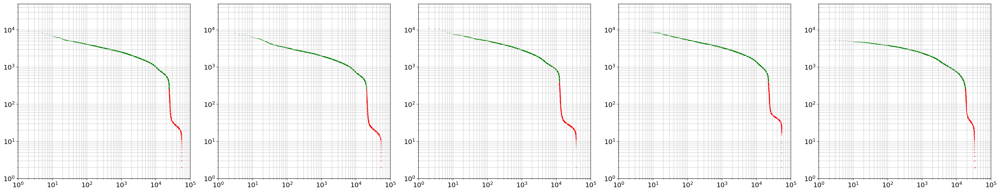

In [20]:
fig, ax = plt.subplots(1, 5, figsize=(30,6))
for well, ax in tqdm(list(zip(wells, np.ravel(ax.T)))):
    df = wells[well]['adata_h'].obs[['n_counts','background']].sort_values('n_counts', ascending=False).copy()
    df['rank'] = range(len(df))
    ax.scatter(df[df['background'] == 'False']['rank'].values, 
               df[df['background'] == 'False']['n_counts'].values, 
               color='g', s=3, linewidth='0')
    ax.scatter(df[df['background'] == 'True']['rank'].values, 
               df[df['background'] == 'True']['n_counts'].values, 
               color='r', s=3, linewidth='0')
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.grid(False) # turn off major, or else major will turn off while minor turns on
    ax.grid(which='both',axis='both') 
    ax.set_xlim(1,1e5)
    ax.set_ylim(1,5e4)
plt.tight_layout()

Make a new object for only filtered cells.

In [21]:
for well in wells:
    wells[well]['adata_filt'] = wells[well]['adata_h'][wells[well]['adata_h'].obs['background'] == 'False'].copy()
    wells[well]['adata_filt'].obs.drop('background', axis=1, inplace=True)

In [22]:
wells[1]['adata_filt']

AnnData object with n_obs × n_vars = 24347 × 20792 
    obs: 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'n_counts'

#### Percent Mito Filtration

In [23]:
for well in wells:
    genelist = wells[well]['adata_filt'].var_names.tolist()
    mito_genes_names = [gn for gn in genelist if gn.startswith('hg38_______MT-')]
    mito_genes = [genelist.index(gn) for gn in mito_genes_names]
    mito_counts = np.ravel(np.sum(wells[well]['adata_filt'][:, mito_genes].X, axis=1))
    wells[well]['adata_filt'].obs['percent_mito'] = mito_counts / wells[well]['adata_filt'].obs['n_counts'].values

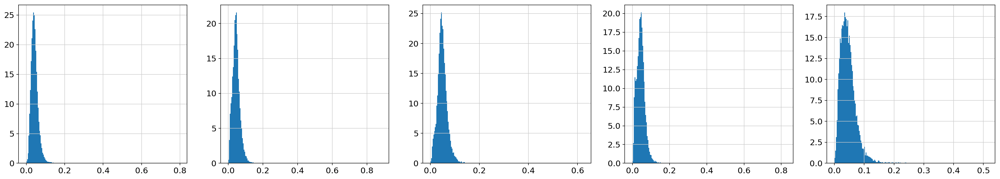

In [24]:
fig, ax = plt.subplots(1, 5, figsize=(30, 5))
for well, ax in zip(wells, ax):
    ax.hist(wells[well]['adata_filt'].obs['percent_mito'].values,bins=200,density=True);

In [25]:
for well in wells:
    wells[well]['adata_filt'] = wells[well]['adata_filt'][wells[well]['adata_filt'].obs['percent_mito'] < 0.1].copy()

Export the filtered barcodes for demuxlet:

In [26]:
# for well in wells:
#     with open(prefix + 'filt.barcodes.tsv/well%s.bcs.tsv' % well,'w') as file:
#         for obs in wells[well]['adata_filt'].obs_names:
#             file.write(obs + '\n')

I merged all the bams and changed the gem-group number at the end of the barcodes. I then ran freemuxlet using the list of good sites from Hyun. Output below.

In [27]:
from nero import Harmonia
import seaborn as sns

In [28]:
for well in wells:
    wells[well]['freemux'] = Harmonia.MuxOut(prefix + "dscpileup.freemux.outs/freemux.out/well%s.samples" % well)

In [29]:
deconvolution = pd.DataFrame(index=range(1,6), columns=[str(i) for i in range(5)])

In [30]:
for i in deconvolution.index:
    for c in deconvolution.columns:
        deconvolution.loc[i, c] = sum(wells[i]['freemux'].sng()['BEST.GUESS'] == c)

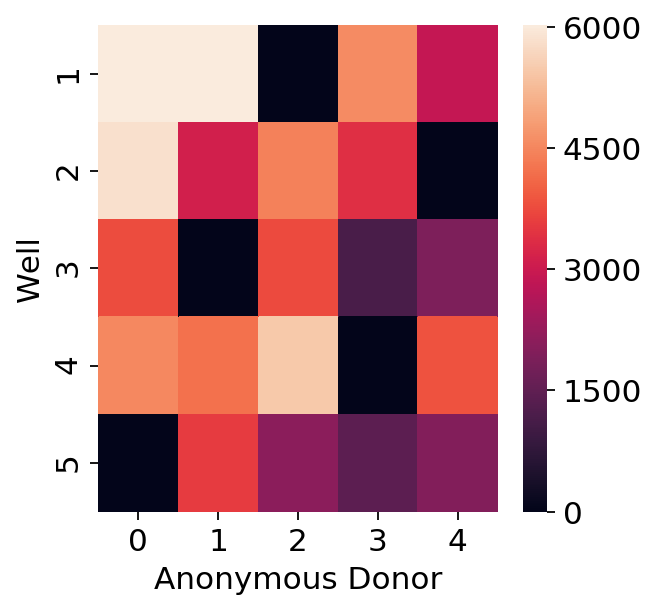

In [31]:
sns.heatmap(deconvolution);
plt.ylabel('Well')
plt.xlabel('Anonymous Donor');

That's amazing. It worked! Now to attach covariates to the donors and then stimulation conditions.

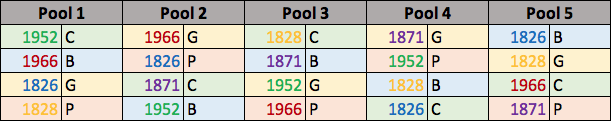

So, based on our scheme, it looks like these are the mappings, in order from 0 to 4:

In [32]:
donor_map = ['52', '26', '71', '66', '28']

In [33]:
condition_map = {1: ['UNSTIM', 'IFN-G', 'MISMAP', 'IFN-B', 'PMA'],
                 2: ['IFN-B', 'PMA', 'UNSTIM', 'IFN-G', 'MISMAP'], 
                 3: ['IFN-G', 'MISMAP', 'IFN-B', 'PMA', 'UNSTIM'], 
                 4: ['PMA', 'UNSTIM', 'IFN-G', 'MISMAP', 'IFN-B'], 
                 5: ['MISMAP', 'IFN-B', 'PMA', 'UNSTIM', 'IFN-G']}

And now, lets generate some covariate DataFrames so we can merge it onto the data.

In [34]:
for well in wells:
    wells[well]['covar_df'] = pd.DataFrame(index=[str(i) for i in range(5)], columns=['IND','COND'])
    wells[well]['covar_df']['IND'] = donor_map
    wells[well]['covar_df']['COND'] = condition_map[well]

Rename barcodes to match what I changed them to outside this notebook.

In [35]:
for well in wells:
    wells[well]['adata_filt'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata_filt'].obs_names]

In [36]:
for well in wells:
    wells[well]['adata_sng'] = Harmonia.ann_merge(wells[well]['adata_filt'], wells[well]['freemux'].sng(), covars=wells[well]['covar_df'])

In [37]:
concat = wells[1]['adata_sng'].concatenate(wells[2]['adata_sng'], 
                                            wells[3]['adata_sng'], 
                                            wells[4]['adata_sng'], 
                                            wells[5]['adata_sng']) # I really shouldn't do this, I should go back and run cellranger aggr, but for now just concatenate

In [38]:
concat.var['n_counts'] = concat.var[[i for i in concat.var.columns if i.startswith('n_counts')]].sum(axis=1)

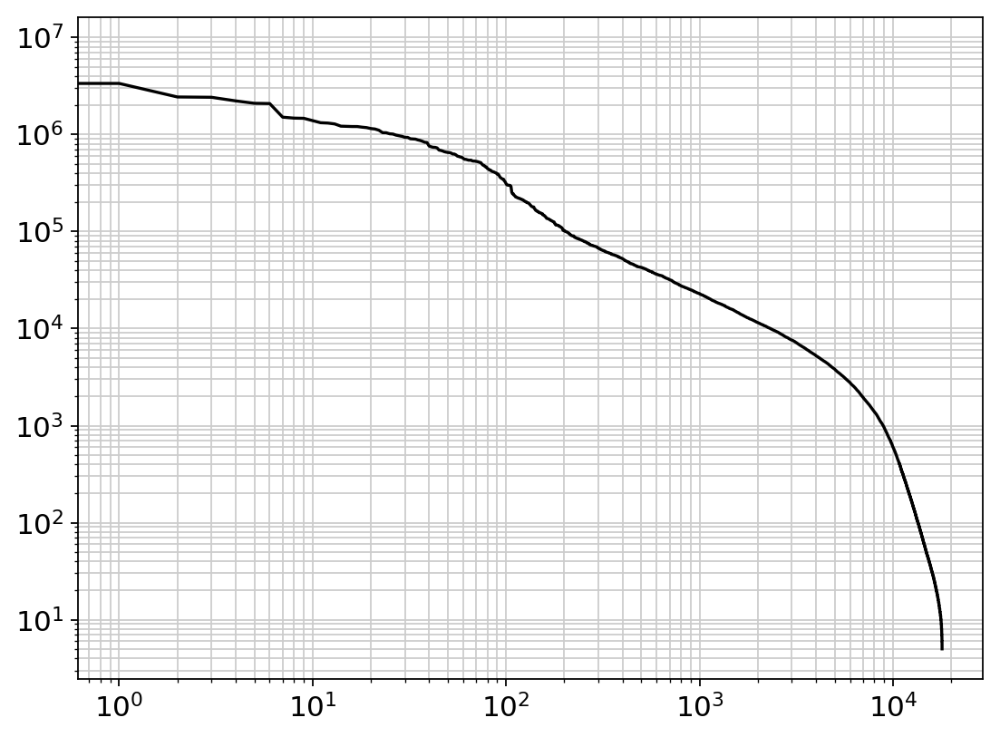

In [39]:
plt.figure(figsize=(8,6))
plt.plot(range(len(concat.var_names)), 
         concat.var['n_counts'].sort_values(ascending=False).values, 
         color='k')
plt.grid(False)
plt.grid(True, 'both', 'both')
plt.xscale('log')
plt.yscale('log')

In [40]:
# remove any genes that are now empty
sc.pp.filter_genes(concat, min_counts=20)

filtered out 2984 genes that are detected in less than 20 counts


In [41]:
concat.var_names = [i[11:] for i in concat.var_names] # get rid of the hg38_______

In [46]:
path = prefix + 'pkls/concat.freemuxed.pkl'

# with open(path,'wb') as file:
#     pkl.dump(concat, file)
    
with open(path,'rb') as file:
    concat = pkl.load(file)

In [47]:
sc.pp.normalize_per_cell(concat, counts_per_cell_after=1e6)

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [48]:
sc.pp.log1p(concat)

Try without combat first.

### Highly-variable Gene Extraction

In recent times, I have been forgoing highly-variable gene extraction because I thought it was just a measure to reduce total size of the matrix so that PCA and subsequent steps were computationally feasible. With AWS, memory and speed considerations are not that critical for me, and so I've generally opted to just keep mostly all genes (barring the small percentage that are barely expressed at all). However, Jessica Neely has mentioned that when she forgoes it, she starts to see some batch effects from some of her wells, and since I ran this pipeline at first and was getting some batch effects, I figured I'd try the variable gene extraction and see if it helps ameliorate the batch effect. Unfortunately it did not, so I'm just going to remove those cells because I'm pretty sure they would be identified by a doublet finder algorithm. We can do that at a later date.

In [49]:
# import matplotlib.patches as patches
# from shapely.geometry import Point
# from shapely.geometry.polygon import Polygon

# def hv_run(adata, flavor='cell_ranger', min_mean=0.0125, min_disp=0.5, max_mean=3, bins=500):    # Extract out highly variable genes, but don't subset just yet
#     '''
#     Run highly variable genes and return a new adata object, if provided.
#     '''
#     hv_adata = adata.copy() # make a copy because I don't want to change the original just yet
#     sc.pp.highly_variable_genes(hv_adata, flavor=flavor,inplace=True, 
#                                 min_mean=min_mean, 
#                                 min_disp=min_disp, 
#                                 max_mean=max_mean,
#                                 n_bins=bins)
    
#     means = hv_adata.var['means'].values
#     means_sorted = np.unique(np.sort(means))
#     if means_sorted[0] == 0:
#         mean_shift = means_sorted[1]
#     elif means_sorted[0] < 0:
#         mean_shift = means_sorted[1] - 2*means_sorted[0]
#     else:
#         mean_shift = 0
    
#     disps = hv_adata.var['dispersions_norm'].values
#     disps_sorted = np.unique(np.sort(disps))
#     if disps_sorted[0] == 0:
#         disp_shift = disps_sorted[1]
#     elif disps_sorted[0] < 0:
#         disp_shift = disps_sorted[1] - 2*disps_sorted[0]
#     else:
#         disp_shift = 0
        
#     log_means = np.log10(means + mean_shift)
#     log_disps = np.log10(disps + disp_shift)
    
#     hv_adata.var['log_means'] = log_means
#     hv_adata.var['log_disps'] = log_disps
    
#     return hv_adata

# def hv_plot(hv_adata, gate=None, highlight_genes=None):
#     '''
#     Plot the means and normalized dispersions from the adata object provided. Choose to
#     also plot a gate or highlight certain genes.
#     '''
#     plt.figure(figsize=(7,7)) # make a figure
#     plt.minorticks_on() # throw on the minor ticks for use with the grid, will help with subsetting
#     plt.grid(True,which='both',axis='both') # turn the grid on
    
#     # do what the scanpy function does, plotting normalized dispersions with means as blue dots, 
#     # I don't want to plot in logspace but I don't want to use the log function because then the gates don't work
#     # if they contain segments with fractional slopes (i.e. non-straight lines). To be robust to these gates, I therefore 
#     # will log10 everything and just plot in linear space
#     log_means = hv_adata.var['log_means'].values
#     log_disps = hv_adata.var['log_disps'].values
    
#     plt.scatter(log_means, log_disps, s=0.5, c='b')
#     if type(highlight_genes) != type(None): # do you want to highlight some genes?
#         mask = [i in highlight_genes for i in hv_adata.var_names] # create a boolean mask of which genes to highlight
#         highlight_means = log_means[mask] # subset only those means
#         highlight_disps = log_disps[mask] # subset only those dispersions
#         plt.scatter(highlight_means,highlight_disps,s=30, facecolors='none', edgecolors='r'); # plot with a red circle around the blue dot
#     if type(gate) != type(None):
#         # You can draw a gate around the genes you want. There should be a check for using only rectangular gates (or only polygons with right angles). 
#         # I have noted that if you try to draw angled lines in log space using the shapely package, the points_in_poly function does not return the right subset of points within the polygon.
#         ax = plt.gca() # if you want to add a gate
#         gatepatch = patches.Polygon(gate,linewidth=1,edgecolor='teal',facecolor='turquoise',alpha=0.5) # create a matplotlib patch for the gate to the plot
#         ax.add_patch(gatepatch); # add the gate to the plot

# def hv_genes(hv_adata, gate, adata=None):
#     '''
#     Receive boolean for genes in gate or new subsetted adata object, if provided.
#     '''
#     # You can subset the genes you want using the gate. Again, there should be a check for using only rectangular gates (or only polygons with right angles). 
#     # I have noted that if you try to draw angled lines in log space using the shapely package, the points_in_poly function does not return the right subset of points within the polygon.
#     genes = list()
#     log_means = hv_adata.var['log_means'].values
#     log_disps = hv_adata.var['log_disps'].values
    
#     pointsmap = map(Point,log_means,log_disps) # make each point a shapely.geometry.Point
    
#     polygon = Polygon(gate) # make your gate a shapely.geometry.Polygon
#     for i in pointsmap:
#         genes.append(polygon.contains(i)) # this is the workhorse, determining which points are in the gate
#     if type(adata) != type(None): # if the adata has been provided, subset it
#         adata = adata[:,genes].copy()
#         return adata
#     else: # if it has not been provided return the boolean array noting which genes will be kept
#         return genes

# Generate a "highly variable adata" object that has run the highly variable genes extraction function. I generate a separate object because I don't want to necessarily change the original object.

# hv_adata = hv_run(concat)

# With the `hv_plot()` function, you can see the whole distribution:

# hv_plot(hv_adata)

# hv_plot(hv_adata, highlight_genes= ['CD8A', 'CD8B', 'CD3D', 'ANK3', 'IL7R', 'CD14','LYZ','CCL2',
#                          'S100A9', 'FCGR3A','MS4A7','VMO1', 'CD19','MS4A1','CD79A', 'KLRF1', 'GNLY', 
#                          'NKG7', 'HLA.DQA1','FCER1A','GPR183', 'CLEC4C','TSPAN13','IGJ', 'PPBP','GNG11'])

# You can draw a gate around the genes you want. There should be a check for using only rectangular gates (or only polygons with right angles). I have noted that if you try to draw angled lines in log space using the shapely package, the points_in_poly function does not return the right subset of points within the polygon.

# xrange = (-1.8, 1.1)
# yrange = (-0.6, 1.2)
# gate = np.array([(xrange[0], yrange[0]), 
#                   (xrange[0], yrange[1]), 
#                   (xrange[1], yrange[1]), 
#                   (xrange[1], yrange[0])])

# hv_plot(hv_adata, gate=gate, highlight_genes= ['CD8A', 'CD8B', 'CD3D', 'ANK3', 'IL7R', 'CD14','LYZ','CCL2',
#                          'S100A9', 'FCGR3A','MS4A7','VMO1', 'CD19','MS4A1','CD79A', 'KLRF1', 'GNLY', 
#                          'NKG7', 'HLA.DQA1','FCER1A','GPR183', 'CLEC4C','TSPAN13','IGJ', 'PPBP','GNG11'])

# You can extract a boolean array of the genes you want:

# genes = hv_genes(hv_adata, gate=gate)

# genes[:10]

# concat.var_names[genes][:10].values

# You can check how many you have:

# sum(genes)

# concat.shape

# You can get a new adata object with your genes now subsetted:

# concat = hv_genes(hv_adata, gate=gate, adata=concat)

# concat.shape

### Dimensionality Reduction and Clustering

In [50]:
concat_unscaled = concat.copy()

In [51]:
sc.pp.scale(concat)

    ... scale_data: as `zero_center=True`, sparse input is densified and may lead to large memory consumption.


computing PCA with n_comps = 100
    finished (0:03:45)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


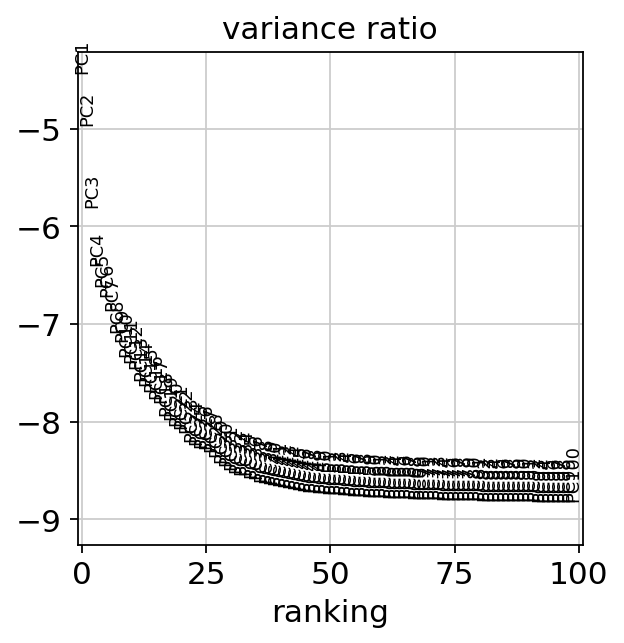

In [52]:
warnings.filterwarnings('ignore')
sc.pp.pca(concat,n_comps=100)
sc.pl.pca_variance_ratio(concat,log=True, n_pcs=100)
warnings.filterwarnings('default')

In [53]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(concat,n_neighbors=15,n_pcs=50) # using all available embeddings, numba warning outlined here is not to be of concern: https://github.com/lmcinnes/umap/issues/252
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 50
    computed neighbors (0:00:26)
    computed connectivities (0:00:05)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:31)


In [54]:
sc.tl.umap(concat)

computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:18)


In [55]:
sc.tl.leiden(concat,resolution=0.2)

running Leiden clustering
    finished: found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:26)


... storing 'BEST.GUESS' as categorical
... storing 'COND' as categorical
... storing 'DROPLET.TYPE' as categorical
... storing 'IND' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


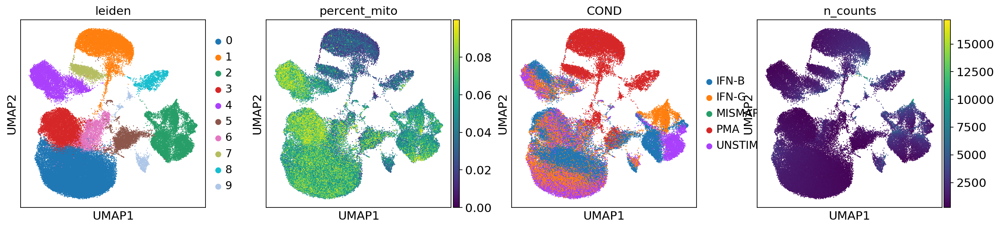

In [56]:
sc.pl.umap(concat,color=['leiden', 'percent_mito', 'COND', 'n_counts'], size=5);

In [57]:
batches = concat.obs['batch'].unique() # get a list of the batches
# make a new column in the `.obs` for each batch that is of dtype `int` and that just takes on values of 0 and 1 so that it gets plotted as a continuous variable instead of a categorical one
for batch in batches:
    concat.obs['batch_%s' % batch] = (concat.obs['batch'] == batch).astype(int)

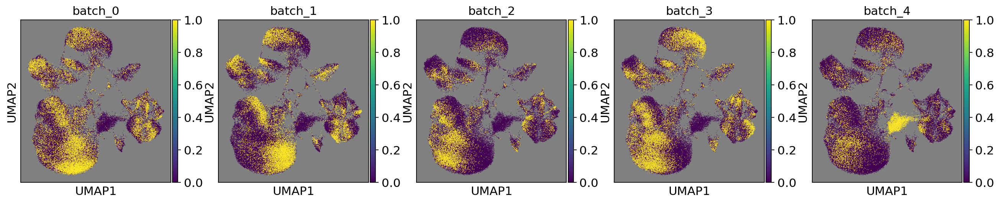

In [58]:
fig, ax = plt.subplots(1, 5, figsize=(20,3.5))
# make a new column in the `.obs` for each batch that is of dtype `int` so that it gets plotted as a continuous variable instead of a categorical one
for batch, ax in zip(batches, np.ravel(ax)):
    ax.set_facecolor('gray')
    sc.pl.umap(concat, color=['batch_%s' % batch], ax=ax, sort_order=True, show=False, return_fig=False)

That lone cluster coming from well 5 was also seen with batch correction, so it's not something that Combat can solve. I will dive a bit deeper into that cluster. First let's see which genes are specifically marking it.

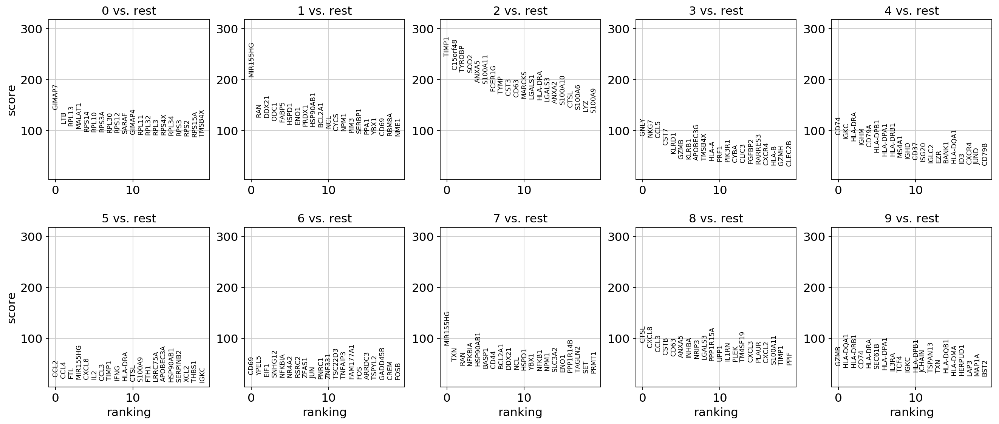

In [65]:
sc.settings.verbosity = 0 
warnings.filterwarnings('ignore')
sc.tl.rank_genes_groups(concat, groupby='leiden')
warnings.filterwarnings('default')
sc.pl.rank_genes_groups(concat, ncols=5)
sc.settings.verbosity = 4

In [67]:
path = prefix + 'pkls/concat.freemuxed.dimred.check1.pkl'

# with open(path,'wb') as file:
#     pkl.dump(concat, file, protocol=4) # protocol=4 required for files larger than 4 GiB
    
with open(path,'rb') as file:
    concat = pkl.load(file)

In [68]:
def get_dge(adata):
    deg_data = pd.DataFrame() 
    for i in ['scores', 'names', 'logfoldchanges', 'pvals', 'pvals_adj']:
        deg_data[i] = np.array(adata.uns['rank_genes_groups'][i].tolist()).flatten()
    return deg_data

In [72]:
get_dge(concat)

,scores,names,logfoldchanges,pvals,pvals_adj
0,141.847305,GIMAP7,NaN,0.000000e+00,0.000000e+00
1,205.815018,MIR155HG,NaN,0.000000e+00,0.000000e+00
2,245.858810,TIMP1,NaN,0.000000e+00,0.000000e+00
3,90.382614,GNLY,NaN,0.000000e+00,0.000000e+00
4,92.655876,CD74,NaN,0.000000e+00,0.000000e+00
...,...,...,...,...,...
995,4.624113,NUSAP1,NaN,3.888489e-06,5.221187e-05
996,11.298699,RBM39,NaN,3.175263e-29,1.877296e-27
997,18.271353,YBX3,NaN,4.712962e-71,5.221962e-69
998,27.463264,SPP1,NaN,4.781987e-132,6.684949e-130


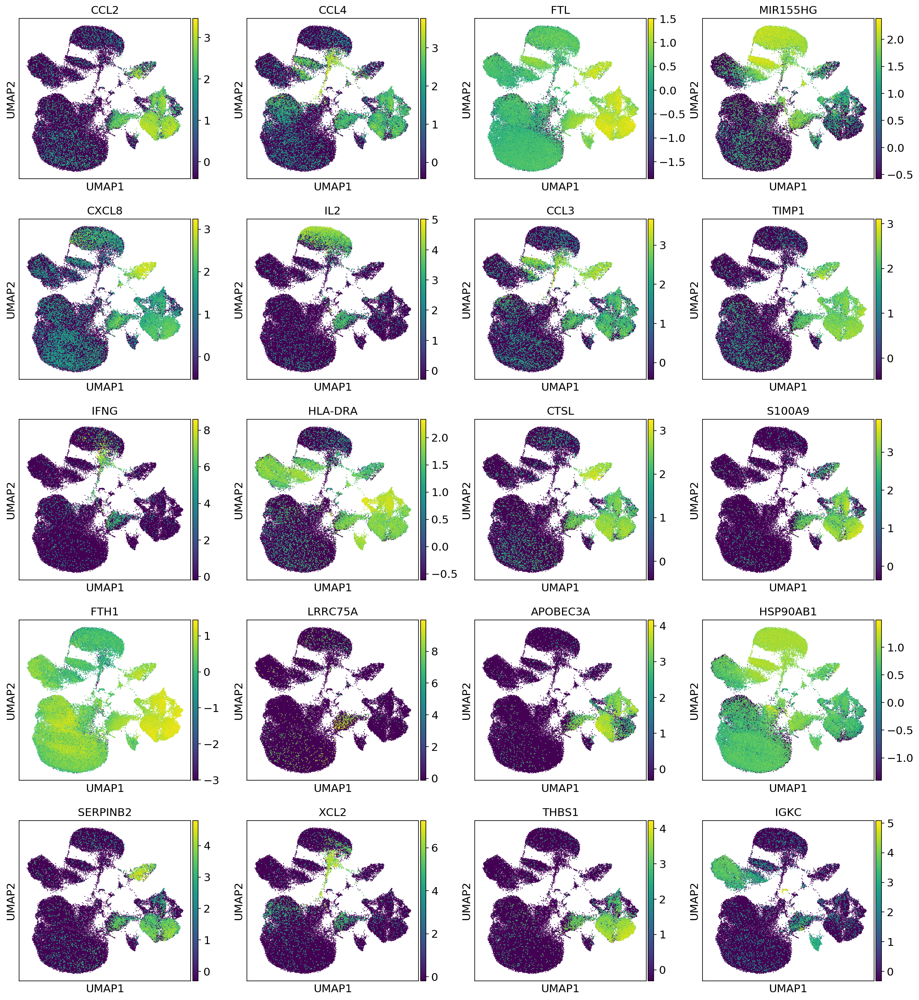

In [73]:
sc.pl.umap(concat,color=[i for i in concat.uns['rank_genes_groups']['names']['5'][:20]], size=5);

It looks like it expresses many markers unique to the myeloid cells, but also IL2 which seems to be unique to that T cell PMA cluster up top. Smells like just low quality droplets with a mess of different transcripts, likely from the wetting failure. 

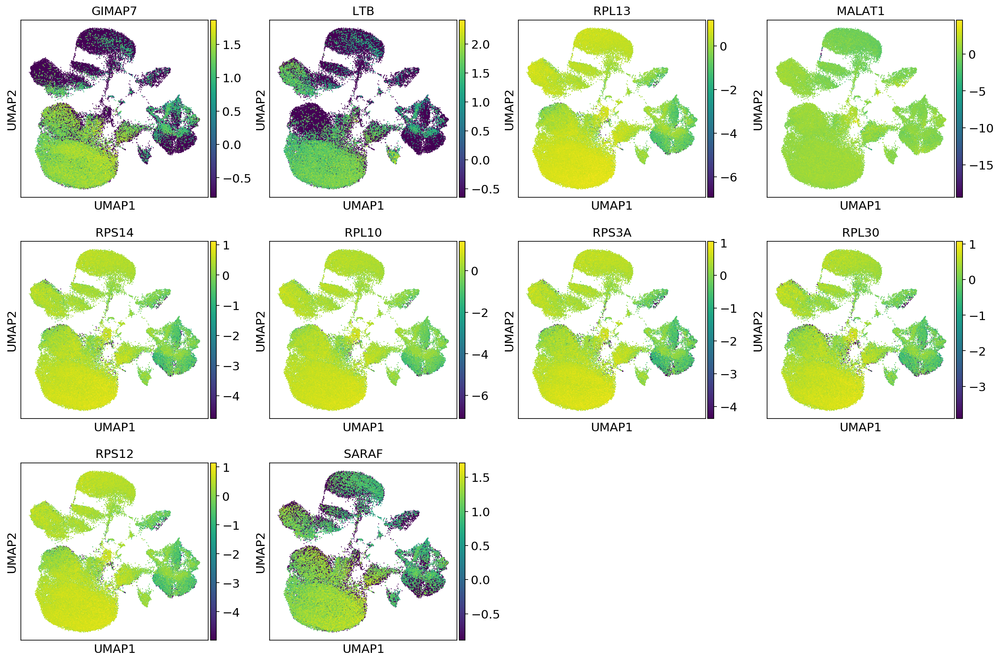

In [74]:
sc.pl.umap(concat,color=[i for i in concat.uns['rank_genes_groups']['names']['0'][:10]], size=5);

I tried to remove the effect of ribosomal PCs below:

In [75]:
total_pcs=50

In [76]:
df_loadings = pd.DataFrame(concat.varm['PCs'], index=concat.var_names)
df_rankings = pd.DataFrame((-1 * df_loadings.values).argsort(0).argsort(0), index=df_loadings.index, columns=df_loadings.columns)

In [77]:
ribo_pcs = list()
for pc in range(total_pcs):
    top_genes = df_loadings[pc].sort_values(ascending=False)[:50].index.values
    ribo_pcs.append(sum([i.startswith('MT') for i in top_genes]))
ribo_pcs = np.array(ribo_pcs)

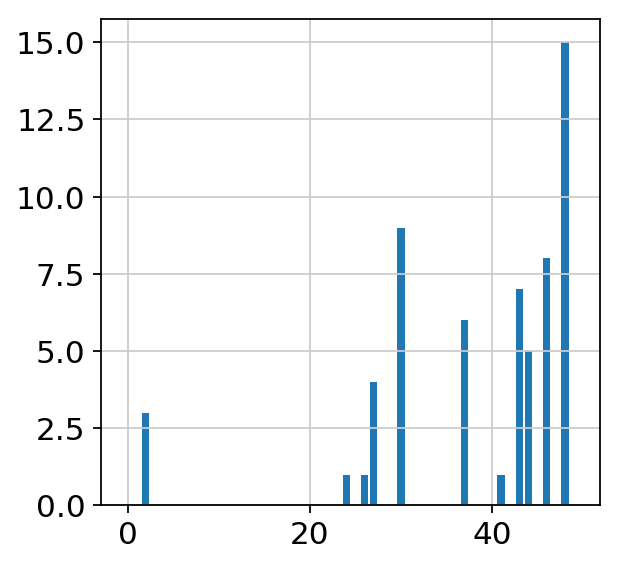

In [78]:
plt.bar(range(total_pcs),ribo_pcs);

Now let's do dimensionality reduction without those PCs. I'm a little scared to get rid of PC3, but we'll see. I first need to re-run with just the first 50.

In [79]:
warnings.filterwarnings('ignore')
sc.pp.pca(concat,n_comps=50)
warnings.filterwarnings('default')

computing PCA with n_comps = 50
    finished (0:01:12)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


In [80]:
pc_keep_bool = ~(ribo_pcs > 5)

In [81]:
pc_keep_bool

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True, False,  True,  True,  True,  True,  True,
        True, False,  True,  True,  True,  True,  True, False,  True,
        True, False,  True, False,  True])

In [82]:
concat.varm['PCs'] = concat.varm['PCs'][:,pc_keep_bool]
concat.obsm['X_pca'] = concat.obsm['X_pca'][:,pc_keep_bool]

In [83]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(concat,n_neighbors=15,n_pcs=pc_keep_bool.sum()) # numba warning outlined here is not to be of concern: https://github.com/lmcinnes/umap/issues/252
warnings.filterwarnings('default')

computing neighbors
        initialized `.distances` `.connectivities` 
    computing neighbors
    using 'X_pca' with n_pcs = 45
    computed neighbors (0:00:22)
    computed connectivities (0:00:02)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:25)


In [84]:
sc.tl.umap(concat)

computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:16)


In [85]:
sc.tl.leiden(concat,resolution=0.2)

running Leiden clustering
    finished: found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:29)


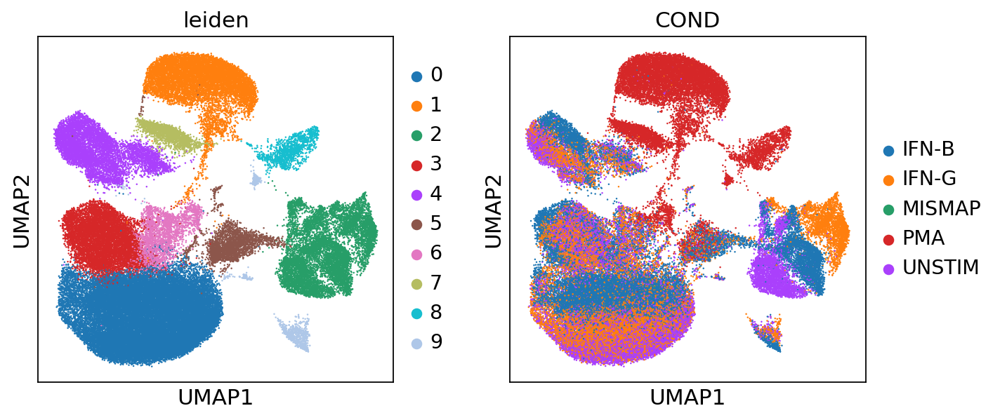

In [86]:
sc.pl.umap(concat,color=['leiden', 'COND'], size=5);

Doesn't seem like it helps all that much. Our cluster 5 is still there. I'm just going to remove those cells (which are likely multiplets) and start analyzing further in another notebook.

In [87]:
path = prefix + 'pkls/concat.freemuxed.dimred.check1.pkl'
    
with open(path,'rb') as file:
    concat = pkl.load(file)

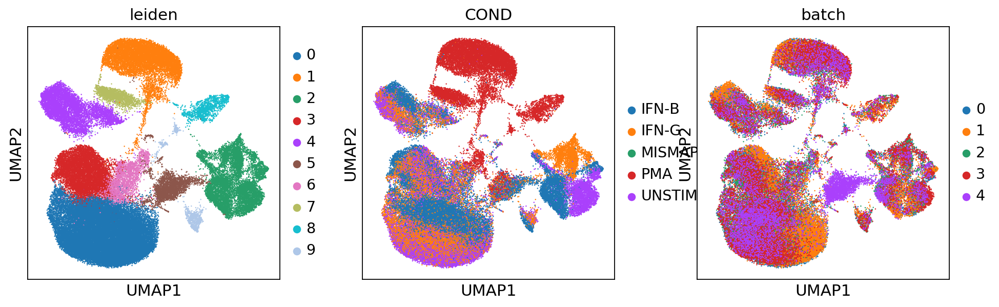

In [88]:
sc.pl.umap(concat,color=['leiden', 'COND', 'batch'], size=5);

In [89]:
sub_concats = dict() # put the new subsetted concat objects in a dictionary of concats
sub_concats['5'] = concat[concat.obs['leiden'] == '5'].copy()
sub_concats['9'] = concat[concat.obs['leiden'] == '9'].copy()

running Leiden clustering
    finished: found 4 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


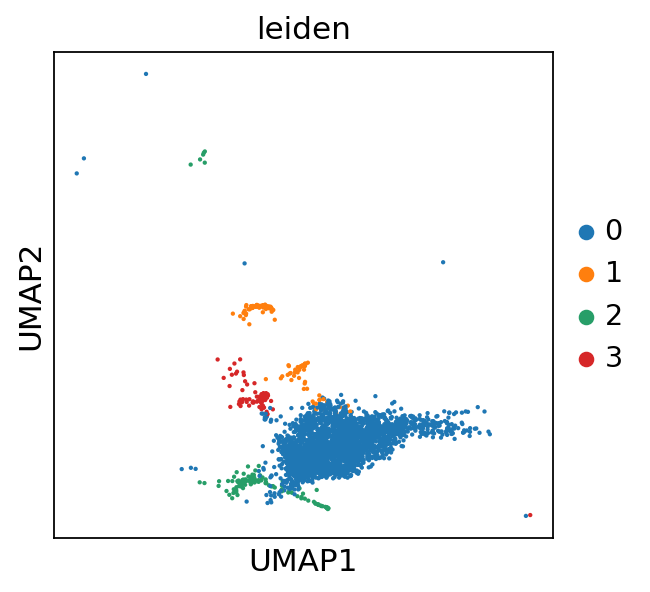

In [90]:
sc.tl.leiden(sub_concats['5'], resolution=0.1) # subcluster them using Leiden
sc.pl.umap(sub_concats['5'], color='leiden', size=15)

running Leiden clustering
    finished: found 3 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


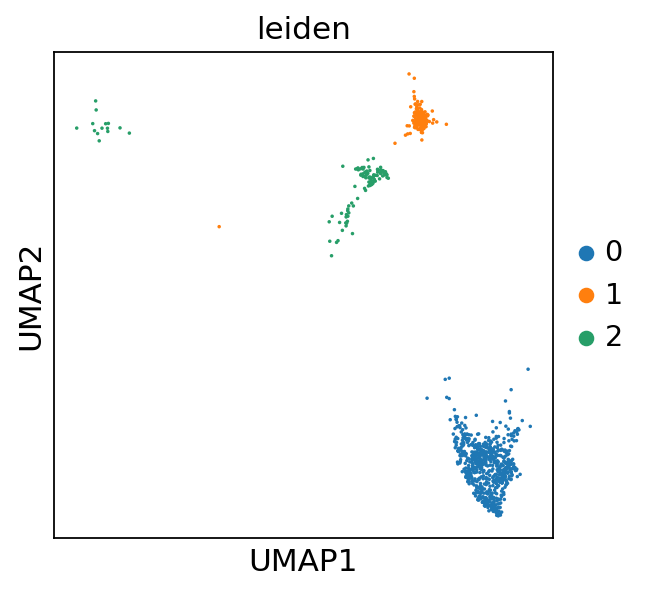

In [91]:
sc.tl.leiden(sub_concats['9'], resolution=0.2) # subcluster them using Leiden
sc.pl.umap(sub_concats['9'], color='leiden', size=10)

Map them back to the clusters on the original adata

In [92]:
def sub_cluster_mapper(adata, sub_adatas):
    '''
    This takes in the adata object and inserts a new leiden column in the `.obs`. 
    
    This function is really convoluted and there's probably a better, simpler way to do it,
    but it should theoretically work for any number of subclusters
    '''
    # ideally you'd make a copy of the adata object here, so we don't have to change the original
    # this would be in case we want to run it multiple times, perhaps the resolutions we put in didn't subset the clusters like we had hoped
    # and we need to run multiple times to adjust the resolution slightly
    
    # this block is to figure out that there are two new subclusters and they should be named 8, 9
    total_new_clusts = 0
    old_clusts = sub_adatas.keys()
    for sub_adata in sub_adatas:
        total_new_clusts += sub_adatas[sub_adata].obs['leiden'].astype(int).unique().max() + 1
    total_added_clusts = total_new_clusts - len(sub_adatas)
    new_clust_names_start = max(adata.obs['leiden'].astype(int))+1
    new_added_clust_names = [str(i) for i in range(new_clust_names_start,
                                                   new_clust_names_start + total_added_clusts)]
    
    # this block is to build a new list of leiden clusters from the old one 
    new_leiden = list()
    leiden_col = adata.obs['leiden'].copy()

    # this builds the new leiden cluster list, now adding a .1, .2, etc. to each new cluster
    for obs in leiden_col.index:
        clust_name = leiden_col.loc[obs]
        if clust_name not in old_clusts or sub_adatas[clust_name].obs.loc[obs, 'leiden'] == '0':
            new_leiden.append(clust_name)
        else:
            new_leiden.append(clust_name + '.%s' % sub_adatas[clust_name].obs.loc[obs,'leiden'])

    # this renames the .1, .2, etc clusters to the new, better names I came up with above (8 and 9)
    new_leiden = pd.Series(new_leiden, index=adata.obs_names)
    added_clusts = np.setdiff1d(new_leiden,adata.obs['leiden'])
    new_leiden.replace(dict(zip(added_clusts, new_added_clust_names)), inplace=True)
    
    # replace the old leiden column, must do these steps sequentially 
    adata.obs['leiden'] = new_leiden.astype(int) # to order the clusters by number
    adata.obs['leiden'] = new_leiden.astype(str) # to convert to string as normal
#     adata.obs['leiden'] = new_leiden.astype('category') # don't do this, it messes things up, just let scanpy do it as it plots
    return adata

In [93]:
concat = sub_cluster_mapper(concat, sub_concats)

... storing 'leiden' as categorical


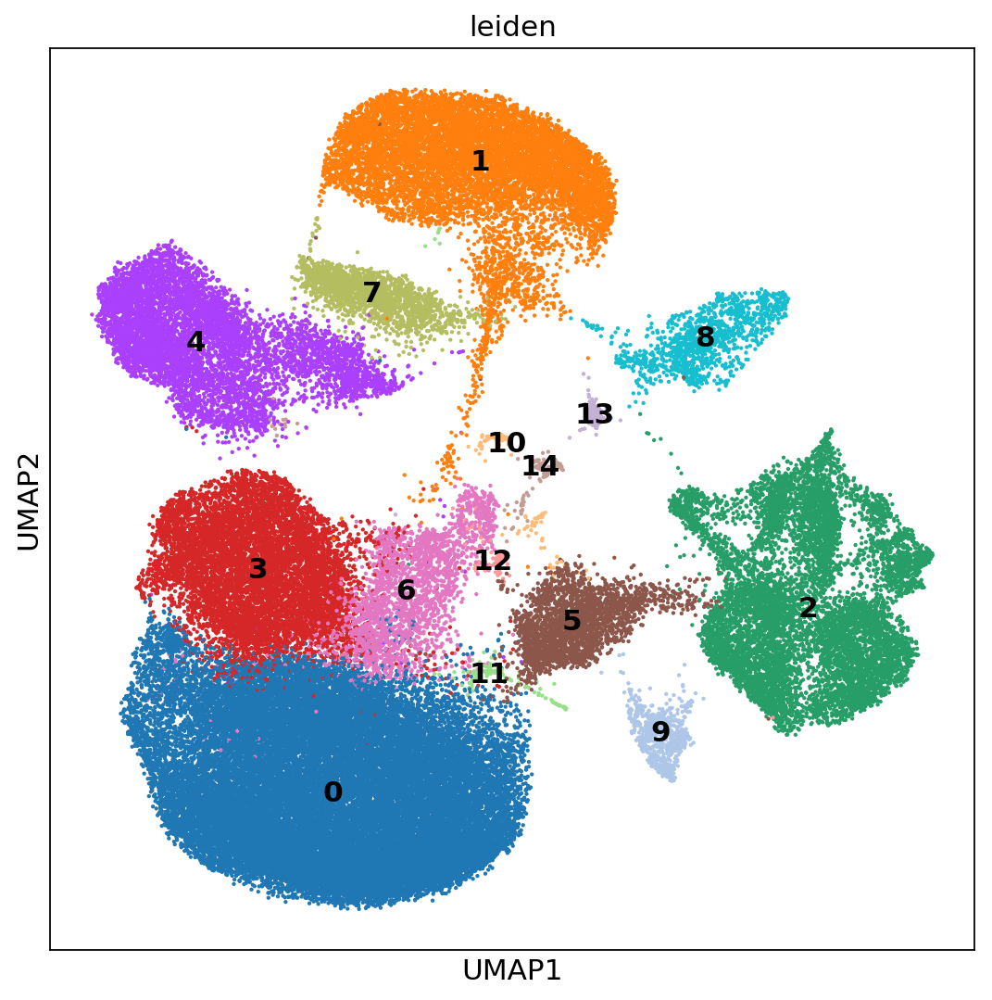

In [94]:
fig, ax = plt.subplots(1,1,figsize=(8,8))
sc.pl.umap(concat,color=['leiden'], ax=ax, size=15, legend_loc='on data', palette=sc.pl.palettes.default_20)

In [95]:
num_clusts = concat.obs['leiden'].dtype._categories.shape[0]
num_batches = concat.obs['batch'].dtype._categories.shape[0]
cluster_props = pd.DataFrame(np.zeros((num_clusts,num_batches)), columns=range(num_batches), index=range(num_clusts))

In [96]:
for i, j in tqdm(it.product(range(num_clusts), range(num_batches))):
    a = concat.obs[concat.obs['batch'] == str(j)].index.values
    b = concat.obs[concat.obs['leiden'] == str(i)].index.values
    c = len(np.intersect1d(a,b))
    d = len(np.union1d(a,b))
    cluster_props.loc[i,j] = c/len(b)

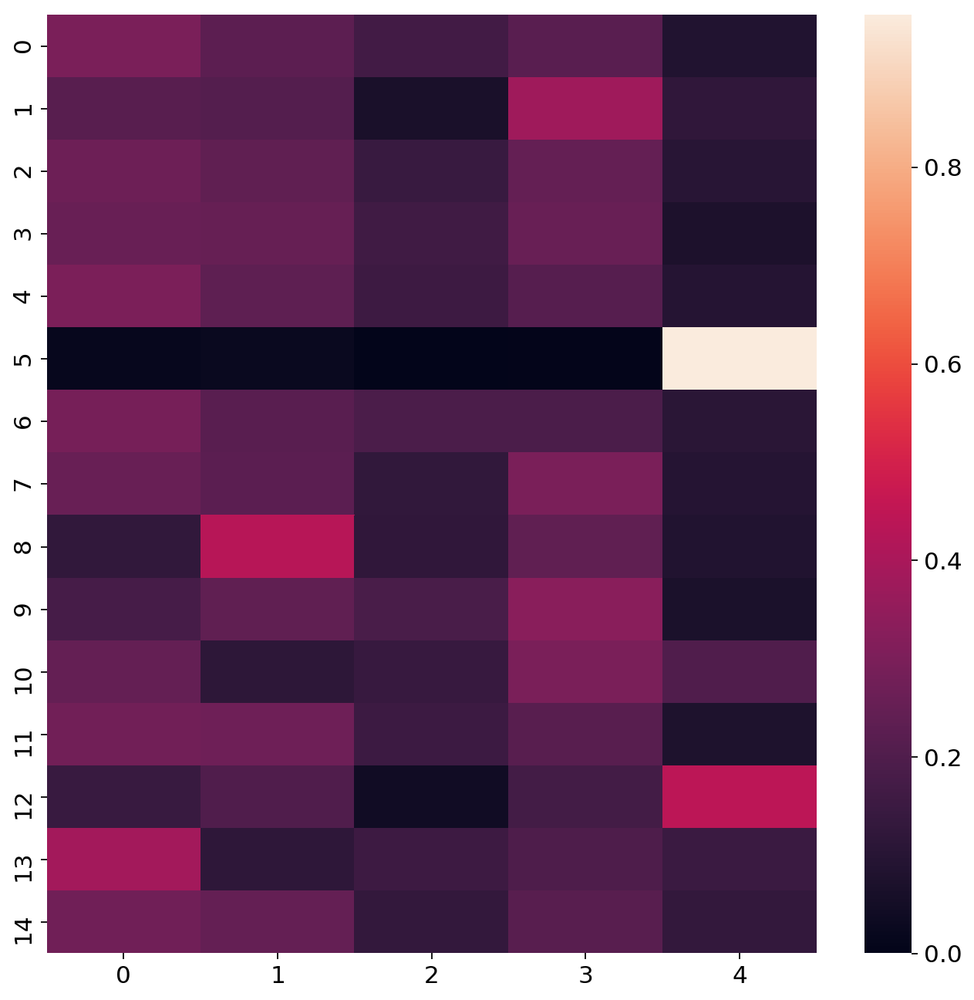

In [97]:
plt.figure(figsize=(10,10))
# sns.clustermap(cluster_props, row_cluster=False, col_cluster=False,standard_scale=0);

sns.heatmap(cluster_props);

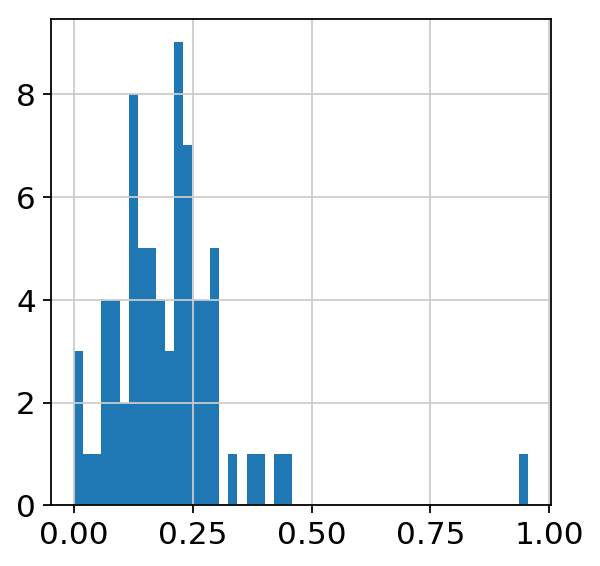

In [98]:
plt.hist(np.ravel(cluster_props.values),bins=50);

In [99]:
concat = concat[concat.obs['leiden'] != '5'].copy() 

In [100]:
path = prefix + 'pkls/concat.freemuxed.dimred.no5.pkl'

with open(path,'wb') as file:
    pkl.dump(concat, file, protocol=4) # protocol=4 required for files larger than 4 GiB
    
# with open(path,'rb') as file:
#     concat = pkl.load(file)